# <span style="color:blue">*QuadrantDetector :* some things you might want to do with this package</span>
### <font color='brown'>Paul Nakroshis, Benjamin Montgomery and Kristen Gardner </font>
### <font color='brown'>Dept. of Physics, University of Southern Maine</font>
#### <font color='brown'>Modified 6 July  2019</font>

##### Abstract
The *quadrantdetector* package allows the user to computationally model the response<br> of a circular quandrant cell photodiode to the passage of a gaussian laser beam across<br> it's surface. This notebook:
    0. imports needed packages
    1. describes the computational model implementation
    2. shows actual data from a beam scanned across the detector
    3. simulate the detector, and find the beam gaussian beam radius
    4. How to extract a position from a set of detector outputs.

### <font color='brown'>(0) Imports for this notebook</font>

In [8]:
import quadrantdetector.detector as qd
import quadrantdetector.sample_functions as qsf

import numpy as np
import pandas as pd
import time
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy import stats
from multiprocessing import Pool

from bokeh.palettes import *
from bokeh.io import output_notebook
from bokeh.plotting import figure,show
from bokeh.layouts import gridplot,row
from bokeh.models import ColorBar
from bokeh.transform import linear_cmap
from bokeh.models import Legend
import colorcet as cc

output_notebook()

Loading BokehJS ...

### Packages used in this notebook:

In [9]:
# if you don't have the version_information package, uncomment the next line (but only once)
#!pip install --upgrade version_information
%load_ext version_information
%version_information numpy, scipy, matplotlib, sympy, version_information

The version_information extension is already loaded. To reload it, use:
  %reload_ext version_information


Software versions
Python 3.7.3 64bit [Clang 4.0.1 (tags/RELEASE_401/final)]
IPython 7.6.0
OS Darwin 18.6.0 x86_64 i386 64bit
numpy 1.16.4
scipy 1.3.0
matplotlib 3.1.0
sympy 1.4
version_information 1.0.3
Fri Jul 05 23:28:22 2019 EDT

# <font color='brown'>(1) Implementation of computational Model</font>
## Detector Geometry
To model our detector, we create a planar space with bounds $(-x_{\textrm{max}}, -y_{\textrm{max}})$ to  $(+x_{\textrm{max}}, +y_{\textrm{max}})$ with the circular detector centered on the origin. Our detector is a quadrant cell photodiode with diameter $d_0 = 7.80\;\textrm{mm}$ and an inactive gap between the cells of width $\delta = 42\;\mu\textrm{m}$. If we break up the detector by a square grid of size $\Delta = \frac{d_0}{n}$, then the cells bordering the gap will have to have an area $\frac{\delta}{2}\Delta$ subtracted from the cell area $da = \Delta^2$. Note that the four cells centered on the origin are exceptions to this, and will have a dead area of $2(\frac{\delta}{2}\Delta)$ subtracted from $\Delta^2$:<br/>
<br/>

<img src="drawings/DetectorGeometryOverview.png" style="float: center;" width="500">

The figure above assumes that the grid size is greater than the gap width, or $\Delta < \delta$, and therefore there  are two rows and two columns of cells that are affected by the dead area. However, to create an accurate model of the detector, we want to choose a gride size sufficiently small so that we can better approximate a true integration of the light intensity. A better scenario, then is to conside a situation like this where the grid size is smaller than the gap:<br/>
<br/>

<img src="drawings/detector.png" style="float:center;" width="500">

So there are two general situations (again, assuming that the detector cells are such that the closest cells' centers are $\Delta/2$ away from the coordinate axes.)<br/>
1. if $\Delta >\frac{\delta}{2}$, then there are only two rows and two columns of cells affected by the dead zone gap, and
2. if $\Delta <\frac{\delta}{2}$, then there are $4N_{\textrm{a}}$ rows/columns affected, where $N_{\textrm{a}}$ is the number of cells' centers within 
   $\frac{\delta}{2} + \frac{\Delta}{2}$; in practice, the condition for a cell to be affected by the dead zone is if $x - \frac{\Delta}{2} < \frac{\delta}{2}$.
   
The electronic connection to the detector receives as input a photocurrent from each quadrant, and returns three signals: 
    1. the sum of all four quadrants,
    2. the top two minus the bottom two, and 
    3. the left two minus the right two. 

The laser used in our optical lever is a 4.9 mW gaussian beam photodiode from Edmund Optics (635nm, VHK Circular Beam Visible Laser Diode). The laser diode specs list the beam diameter of 1.1 mm at the aperature, but we have a 1.0 m focal length lens that focusses the spot onto our photodiode plane, resulting in a smaller beam (as we shall see, with $\sigma = 0.320$ mm (corresponding to a Full Width at Half Maximum (FWHM) ~ 2.355σ ~ 0.754 mm).

The goal of this notebook is to model the detector response to a gaussian beam of known width. Then, because our detector is mounted on a linear translation stage, we can move the actual beam across the detector and adjust beam width in the simulation until we match the actual signal from our detector. 

##  Visualization of detector and laser beam 
Here we create a simple function, plot_scenario, to show the output of our simulation:

In [12]:
def plot_scenario(laser, detector):
    palette=cc.b_linear_kryw_5_100_c64
    # Draw the detector
    detector_fig = figure(title="Detector visualization",
                          x_axis_label="x axis (mm)", y_axis_label="y axis (mm)",
                          x_range=(-det_diam/2, det_diam/2), y_range=(-det_diam/2, det_diam/2),
                          plot_width=325, plot_height=325)
    detector_fig.image(image=[detector], x=-det_diam/2, y=-det_diam/2,
                       dw=det_diam, dh=det_diam, palette=palette)
    
    # Draw the laser
    laser_fig = figure(title="Laser visualization",
                       x_axis_label="x axis (mm)", y_axis_label="y axis (mm)",
                       x_range=(-det_diam/2, det_diam/2), y_range=(-det_diam/2, det_diam/2),
                       plot_width=325, plot_height=325)
    laser_fig.image(image=[laser], x=-det_diam/2, y=-det_diam/2,
                    dw=det_diam, dh=det_diam, palette=palette)
    
    # Add a visual guide for the intensities of the colors on the right side of the figure
    mapper = linear_cmap(field_name='y', palette=palette,
                         low=laser.min(), high=laser.max())
    # Now, overlay the grid and the laser
    merged_fig = figure(title="Merged visualization", x_axis_label="x axis (mm)",
                        y_axis_label="y axis (mm)",
                        x_range=(-det_diam/2, det_diam/2), y_range=(-det_diam/2, det_diam/2),
                        plot_width=325, plot_height=325)
    merged_fig.image(image=[laser * detector], x=-det_diam/2, y=-det_diam/2,
                         dw=det_diam, dh=det_diam, palette=palette)
    #color_bar = ColorBar(color_mapper=mapper['transform'], width=10,  location=(10,0))
    #merged_fig.add_layout(color_bar, 'right')
    show( row(detector_fig, laser_fig, merged_fig) )
    
    return None

Now define a detector, how many chunks to break it up into, diameter, gap size, and then define a laser beam:

In [13]:
# detector parameters:
det_diam = 7.8
num_chunks = 1000
gap = 0.2 # made this large so that you can see the gap
# laser parameters:
x_center, y_center = 2.0, 0.0
sigma = 2.0
# now create the detector array and the laser array:
curr_detector = qd.create_detector(num_chunks,det_diam, gap, roundoff=1e-14)
curr_laser = qd.laser(det_diam, num_chunks, x_center, y_center, sigma)

Now show the detector array (black areas correspond to dead areas), the laser beam intensity, and the merged visualization:

In [14]:
plot_scenario(curr_laser, curr_detector)

#  <font color='brown'>(2) Actual data from a real quadrant cell photodiode</font> 
We fixed the laser beam position on the detector, and manually moved the detector plane (with a resolution of 0.01 mm) across the beam, recording the top-bottom detector response. The first column is the actual micrometer reading in millimeters and the second column is the rescaled sensor position (where zero position is where the laser is centered on the detector. Here is the data:

Now execute the code with a gap $\delta = 0.2$ mm; you can see the masked out areas, and you see that the
sum signal decreases while the others remain essentially unchanged.

In [19]:
# the data file has position in mm and detector voltage in volts
calibration_data = pd.read_csv("../MeasuredData/DetectorPositionVoltageData.txt",
                               delimiter=" ", names=['Micrometer', 'dx', 'T-B', 'dT-B'])
calibration_data.head()

,Micrometer,dx,T-B,dT-B
0,12.0,6.21,0.07,-0.005663
1,11.5,5.71,0.14,-0.011327
2,11.0,5.21,0.15,-0.012136
3,10.5,4.71,0.24,-0.019417
4,10.4,4.61,0.29,-0.023463


We need to normalize our data to 1, and account for the fact that in our actual experimental data gathering process, T-B was actually the inverse of L-R.

In [20]:
calibration_data['L-R'] = -calibration_data['T-B'] / calibration_data['T-B'].abs().max()

Here is a plot of the actual detector response (where the signal response has been normalized)

In [21]:
p = figure(sizing_mode="fixed", aspect_ratio = 1.414, title="Measured Signal",
           x_axis_label="Micrometer Position (mm)", y_axis_label="L-R Signal (normalized)")

p.scatter(calibration_data['dx'], calibration_data['L-R'], legend='Measured',
          alpha=0.5, muted_alpha=0.2)
show(p)

# <font color='brown'>(3) Modeling our detector system</font> 
Now we need to simulate our detector system (the quadrant cell photodiode and the laser beam that drives it),
and try to achieve the same curve as measured above.
The functions that implement the scheme previously
described are contained in the file physics.py.
First we define our detector's diameter, gap size, and the radius of the simulated beam:

In [22]:
# Our system
d0 = 7.80   # diameter of photocell in mm
δ = 0.042   # gap between the 4 quadrants; also in mm
σ = 0.320   # gaussian radius of our laser beam 

Now we define the simulation parameters. The minimum number of cells to divide the detector into is defined by fitting at least two cells within the gap distance, $\delta$, hence 

$$
n_{\mathrm{critical}} = \frac{d_0}{\left(\delta/2\right)} = \frac{2d_0}{\delta};
$$
the function `n_critial` makes sure that the number $n_{\mathrm{critical}}$ is even (to make sure our cell grid is centered symmetrically about $x=0$). For our case, this mimumum number is:

In [23]:
print("minimum value of n = ",qd.n_critical(d0, δ))

minimum value of n =  372


From experience, our code can easily handle arrays of size 1000x1000, so in the code below, we'll choose an N value of at least 3 times this minimum value. <br>
You'll notice I've introduced a variable $\epsilon$ (a "fudge factor"). This was a needed factor when deciding if a cell was in the gap region using a floating point comparison. The code in `detector.create_detector` needs this factor, and it is called be `detector.signal_over_path`. However, the code is set up to default to $\epsilon = 1e-14$; I just wanted to make this factor explicit, and it is so small as to be inconsequential in the end result.

In [24]:
# Simulation parameters

# choose a reasonable minimum n value; since the minimun is 372, we can easily do far better:
n = 3*qd.n_critical(d0, δ)
# fudge factor due to roundoff error in case where δ = 2Δ
ϵ = 1e-14

# grid size for simulation
Δ = d0 / n

# maximum horizontal displacement of beam from origin in actual data
xmax = calibration_data['dx'].abs().max()

# number of sample points set to twice the number as in actual data
n_samples = 2 * len(calibration_data)

# library function that describes the y coordinate of the beam
track_func = qsf.center_path

print("Building: ", n, "by", n, " Array")
print("Pixel Size: Δ = %.6f " % (Δ))
print("Sampling response from -", xmax, " to +", xmax, " in ", n_samples, " steps")

Building:  1116 by 1116  Array
Pixel Size: Δ = 0.006989 
Sampling response from - 6.21  to + 6.21  in  192  steps


In [25]:
start_time = time.time()

# Try a range of sigma values in order to fit the data
sigma_range = np.arange(0.30, 0.40, 0.01)
#sigma_range = np.array([0.1,1,2,3,4])
allargs = [(n, d0, δ, xmax, sigma, track_func, n_samples, ϵ) for sigma in sigma_range]

# Actually compute the signal over the provided path for all sigma factors
with Pool(8) as processes:
    results = processes.starmap(qd.signal_over_path, allargs)

print("Runtime = %s seconds ---" % round(time.time() - start_time, 2))

Runtime = 41.78 seconds ---


Now plot the simulation results and overlay the actual data points for comparison. I've determined the best fit
by trial and error, placing visual concern over the linear portion in the center. The fact that the model doesn't fit 
the data as the spot moves off the detector may be due to light scattering as the beam leaves the detector, 
but this has not been verified.

In [26]:
colors = cc.b_linear_bgyw_15_100_c67
color_density = int(len(colors) / len(results))

p = figure(sizing_mode="fixed", title="Simulated and Measured Signals",
           x_axis_label="Position (mm)", y_axis_label="Detector Signal",  plot_width=900, plot_height=500)

p.scatter(calibration_data['dx'], calibration_data['L-R'], legend='Measured',
          alpha=0.5, color=colors[0], muted_alpha=0.2)
legend_it = []

for i, result in enumerate(results):
    # Extract our results
    xp, sum_signal, lr_signal, tb_signal = result
    
    # Scale the left-right signals by the maximum value of the smallest beam radius.
    lr_signal /= max(np.abs(lr_signal))
    
    # Actually plot the result
    c = p.line(xp, lr_signal,
           alpha=0.7, color=colors[i * color_density], muted_alpha=0.2)
    legend_it.append(("Simulated at σ = %.2f" % (sigma_range[i]), [c]))

legend = Legend(items=legend_it, location=(5, 160))
legend.click_policy="mute"

p.add_layout(legend, 'right')
    
#p.legend.location = "top_right"
#p.legend.click_policy="mute"

show(p)

### Comments on the simulation
Looking at the plot above, the simulation seems to fit the data pretty well when $\sigma = 0.32\pm 0.02\;\mathrm{mm}$; the extra signal on the outside shoulders is likely due to scattering of the laser beam off the edges of the detector as it enters or leaves the outer radius of the photodiode, although I haven't verified this conjecture yet.

## Automated fitting to find the laser beam diameter from calibration data
It is somewhat tedious to find the best fit laser beam diameter, so here is a function to do this.

In [114]:
def find_sigma(time_arr, diff_arr, n, d0, δ, σ, track, ϵ=1e-14):
    """
    This routine executes the compute_signals function multiple times over
    a user specified path function and returns the path and the expected
    signals.

    Parameters
    ----------
    time_arr : array_like
    diff_arr : array_like
    n : int
        Number of cells to divide diameter up into
    d0 : float
        Diameter of detector in mm
    δ : float
        Gap width between quadrants of detector in mm
    track :
        A function describing path across detector
    ϵ : float
        Fudge factor needed for roundoff error (default = 1e-14)
    """
    area = qd.create_detector(n, d0, δ, ϵ)  # create detector array
    all_results = [qd.compute_signals(qd.laser(d0, n, x_val, 0, σ), area)
                   for x_val in time_arr]
    sum_sig, lr_sig, tb_sig = zip(*all_results)

    return time_arr, sum_sig / max(sum_sig), lr_sig / max(lr_sig), tb_sig / max(tb_sig)

In [115]:
to_find = lambda pos, sigma: find_sigma(pos, calibration_data['L-R'].values, n, d0, δ, sigma, track_func)[2]

In [116]:
popt, pcov = curve_fit(to_find, -calibration_data['dx'].values, calibration_data['L-R'].values, p0=0.32)
popt, pcov

/Users/pauln/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:27: RuntimeWarning: divide by zero encountered in true_divide
/Users/pauln/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:27: RuntimeWarning: invalid value encountered in true_divide


(array([1.13070079]), array([[0.97805912]]))

In [117]:
p = figure(sizing_mode="fixed", title="Simulated and Measured Signals",
           x_axis_label="Position (mm)", y_axis_label="Detector Signal", plot_width=900, plot_height=500)

p.scatter(calibration_data['dx'], calibration_data['L-R'], legend='Measured',
          alpha=0.5, muted_alpha=0.2)
p.scatter(-calibration_data['dx'].values, to_find(-calibration_data['dx'].values, 0.35),
          legend='Generated by Inspection')

p.line(-calibration_data['dx'].values, to_find(-calibration_data['dx'].values, popt[0]),
       legend='Generated by Least-Squares')
show(p)

/Users/pauln/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:27: RuntimeWarning: divide by zero encountered in true_divide
/Users/pauln/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:27: RuntimeWarning: invalid value encountered in true_divide


# <font color='brown'>(4) Converting the quadrant cell signals to a position</font> 
Suppose we sweep a laser beam across the detector. The standard way (see, for instance http://www.osioptoelectronics.com/application-notes/AN-Using-Photodetectors-Position-Sensing.pdf) to approximate the (x,y) position of the beam center is to use: <br>

$$ x = \frac{\mathrm{left-right}}{\mathrm{sum}}$$

and 

$$ y = \frac{\mathrm{top-bottom}}{\mathrm{sum}}$$

Let's see how well this works for our simulation. We define our detector with diameter 7.8 mm, gap of 0.042 mm, and sweep a beam across the center of the detector from $x = -10\,\mathrm{mm}$ to $x = +10\,\mathrm{mm}$.


In [63]:
def my_detector(σ, δ, path_length=4, return_all=False):
    """
    This function sweeps a beam across the center of the detector.
    
    Inputs: 
    σ          : gaussian beam width in mm
    δ          : the gap between detector quadrants in mm
    path_length: factor multiplying σ (default=4)
    return_all : boolean flag which determines return statement
   
    Returns:
    a) the path across the detector and 
       the normalized beam coordinates     (return_all=False)
    b) the path across detector, normalized beam coordinates,
       and the three raw detector signals  (return_all=True)
    
    notes: (1) the path across the detector will be defined as 
               a multiple of the beam radius:
               xmin, xmax = -path_length*σ, path_length*σ
               The reason for this is that the detector will 
               saturate when it is far from the center, and 
               resulution will be lost. One can override the 
               default value of 4 if one wants. 
    """
    d0 = 7.80   # diameter of photocell in mm
    n = max(1000, 4*qd.n_critical(d0, δ))  # minumum number of cells =1000; go higher if needed
    ϵ = 1e-14 # needed fudge factor
    xmin = -path_length * σ
    xmax = +path_length * σ
    n_samples = 400 # number of samples for simulation
    track_func = qsf.center_path # path across detector
    # use the quadrantcelldetector package to compute the signals
    x, sum_sig, lr_sig, tb_sig = qd.signal_over_path(n, d0, δ, xmax, σ, track_func, n_samples, ϵ)
    # now define the normalized "position" signals:
    x_exp = np.array(lr_sig)/np.array(sum_sig)
    y_exp = np.array(tb_sig)/np.array(sum_sig)
    if return_all:
        return  x, x_exp, y_exp, sum_sig, lr_sig, tb_sig
    else:
        return x, x_exp, y_exp

Now let's look at the output for our detector; compute the signals as well as the normalized positions 
so that you can see the shape of the various signals:

In [81]:
σ = 0.32
δ = 0.042
path_length = 20
x, x_norm, y_norm, sum_sig, lr_sig, tb_sig = my_detector(σ, δ, path_length, return_all=True)

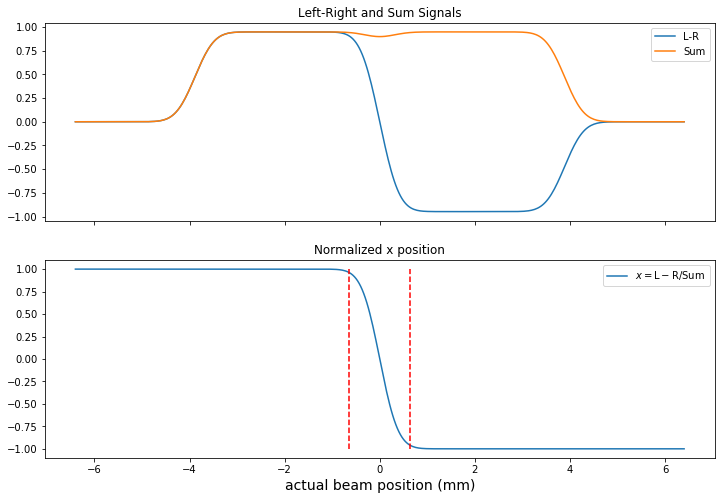

In [87]:
plt.figure(figsize=(12,8))
ax1 = plt.subplot(211)
plt.plot(x,lr_sig, label='L-R')
plt.plot(x, sum_sig, label='Sum')
plt.setp(ax1.get_xticklabels(), fontsize=10, visible=False)
plt.title("Left-Right and Sum Signals")
plt.legend()
# share x only
ax2 = plt.subplot(212, sharex=ax1)
plt.plot(x,x_norm, label=r'$x = \mathrm{L-R/Sum}$' )
plt.plot([-2*σ, -2*σ], [-1,1], '--r')
plt.plot([2*σ, 2*σ], [-1,1], '--r')
plt.title("Normalized x position")
plt.xlabel('actual beam position (mm)', fontsize=14)
plt.legend()
plt.show()

Notice that:<br>
(a) normalized x position saturates when the beam position is outside twice the gaussian beam radius (the two dashed red lines demarcate this region). Hence, we cannot determing the beam position outside this range.<br>
(b) the dip in the sum signal around $x=0$ is expected because of the dead area of width $\delta$. It should be noted that no articles that we have seen take this into account (because it's too difficult theoretically to compute in any insightful way).<br>  
In addition, notice that the normalized x position looks like an upside down hyperbolic tangent! This suggests that we might be able to use this to fit the simulation output; try a fit of the form

$$ x_{\mathrm{norm}} = -a \tanh \left(b\frac{x}{\sigma}\right) $$

where $a$ and $b$ are the fit parameters (we expect that $a\approx 1.0$), and $\frac{x}{\sigma}$ is the ratio of the position to the beam radius. Define this fit function and also create a function to find the best fit values of $a$ and $b$:

In [109]:
def func(x, a, b):
    return -a * np.tanh(b * x/σ) 

def find_b(σ, δ, return_all=False):
    x, x_exp, y_exp = my_detector(σ, δ, 3)
    popt, pcov = curve_fit(func, x, x_exp)
    if return_all:
        return popt,pcov, x, x_exp
    else:
        return popt, pcov

Let's see how well this fits for our detector; first compute the signal and the fit for our detector:

In [110]:
popt, pcov, x, x_norm = find_b(0.320, 0.042, return_all=True)

Now plot the results:

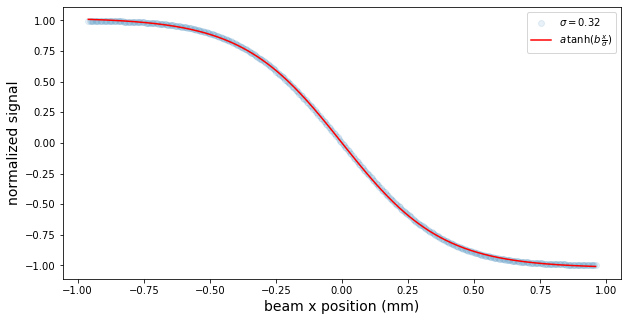

In [113]:
plt.figure(figsize=(10,5))
plt.plot(x, x_norm, 'o',alpha=0.1, label=r'$\sigma = 0.32$')
plt.plot(x, func(x,popt[0],popt[1]), '-r', label=r'$a\,\tanh(b\,\frac{x}{\sigma})$')
plt.xlabel('beam x position (mm)', fontsize=14)
plt.ylabel('normalized signal', fontsize=14)
plt.legend()
plt.show()

Now create as range of beam radii, and compute the best fit parameters.
This cell will take a long time to run!

In [53]:
sigmas = np.append(np.linspace(0.05,0.25,5), np.linspace(0.3,4.3,9))
b = []
for s in sigmas:
    popt, pcov = find_b(s,0.042)
    b.append(popt[1])
    print(s, b[-1])
# grab values
beam_width_sigmas = sigmas
b_fit_vals = b

0.05 7.033496236736158
0.1 3.060937794124882
0.15000000000000002 1.9439348821947107
0.2 1.42235765488451
0.25 1.1209730488775709
0.3 0.9248078708253787
0.8 0.33598190883315676
1.3 0.19984715962083816
1.8 0.12861158608400947
2.3 0.0865634798452527
2.8 0.06124074525734736
3.3 0.04527828863133521
3.8 0.034709495462797745
4.3 0.027399163478199835


Now plot the fit values:

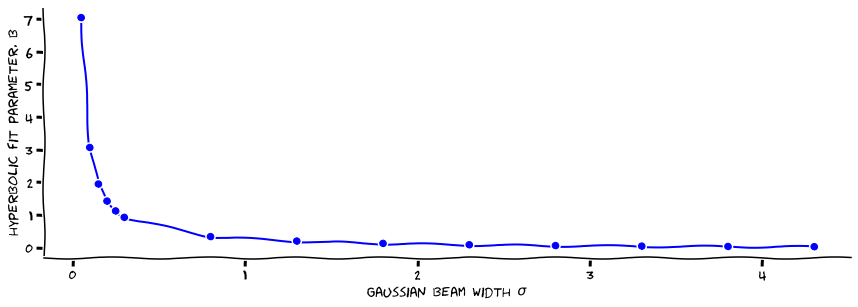

In [93]:
with plt.xkcd():
    fig = plt.figure(figsize=(14,5))
    ax = fig.add_axes((0.1, 0.2, 0.8, 0.7))
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    #ax.set_xticks([])
    #ax.set_yticks([])
    ax.set_xlabel(r'Gaussian beam width $\sigma$')
    ax.set_ylabel('hyperbolic fit parameter, b')
    ax.plot(sigmas, b, '-bo')

## Two methods to find the beam position
With the caveat that the beam pass across the detector's center (we leave it to the reader to generalize to both horizonal and vertical positions varying), we see two methods to determine the beam position from the output of a quadrant cell photodiode---both methods rely on the user first performing a calibration run to determine the gaussian beam radius and then proceeding in one of two ways:<br>
**Method 1:** <br>
    a. Compute the normalized $x$ position from the detector output via <br>
    $$ x = \frac{\mathrm{left-right}}{\mathrm{sum}}$$
    b. Compute the simulated normalized position function for your detector over a range of roughly $\pm 4\sigma$---use a sufficient number of points to allow a high position resolution. 
    c. Then, for a given actual normalized signal value, use the simulated normalized position data (coupled with the range of beam centers used to produce this) to perform a reverse lookup and determine the beam position.
    
**Method 2:** <br>
    a. Compute the normalized $x$ position from the detector output via <br>
    $$ x = \frac{\mathrm{left-right}}{\mathrm{sum}}$$
    b. Compute the simulated normalized position function for your detector over a range of roughly $\pm 4\sigma$---use a sufficient number of points to allow a high position resolution. 
    c. Fit the output of the simulation to the hyperbolic tangent function, then, once one knows the fit parameters $a$ and $b$, it is a simple matter to compute the position via:
    $$ x_{\mathrm{beam}} = \frac{\sigma}{b}tanh^{-1}\left(\frac{x_{\mathrm{norm}}}{a}\right)$$

